#**1) PRE-PROCESSING**

---


Importing the libraries.

In [ ]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import requests
import re
import math
import os

# Graphics Libs
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = 18, 8

# Images Processing Libs
from skimage import io
import cv2
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from PIL import Image

# Models Libs
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.nn import functional as F
from torch.nn import BCEWithLogitsLoss
from torch.optim import Adam
from torch.utils.data import DataLoader
from torchvision.transforms import CenterCrop
from torch.utils.data import Dataset
from tqdm import tqdm
from sklearn.model_selection import train_test_split
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print('Current Device is: ', device.upper())

# Metrics Libs
from sklearn.metrics import jaccard_score

Current Device is:  CUDA


Defining remote paths.

In [ ]:
TRAIN_PATHS = [
    # Field A
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/Field_A/Ses1/',
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/Field_A/Ses2/',
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/Field_A/Ses3/',
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/Field_A/Ses4/',

    # Field B
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/Field_B/Ses1/undistorted/',
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/Field_B/Ses2/undistorted/'
]
TEST_PATHS = [
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/weedmap/Tiles/RedEdge/003/groundtruth/',
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/weedmap/Tiles/RedEdge/003/tile/RGB/',
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/weedmap/Tiles/RedEdge/003/mask/'
]
PROCESSED = [
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/processed/training_data/',
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/processed/training_labels/',
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/processed/testing_data/',
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/processed/testing_labels/'
]
MODELS = [
    'https://cdn.albertovalerio.com/datasets/crop_segmentation/models/my_unet_model.pth'
]

Defining helper function.

In [ ]:
def get_images(url):
	"""Returns the list of images filenames in a given folder
	Args:
	url: Folder path
	"""
	r = requests.get(url).content.decode()
	return re.findall('<td><a href=[\'"]?([^\'" >]+)', r)[1:]


def center_crop(img, dim):
	"""Returns center cropped image
	Args:
	img: Image to be center cropped
	dim: Dimensions (width, height) to be cropped
	"""
	width, height = img.shape[1], img.shape[0]
	crop_width = dim[0] if dim[0] < img.shape[1] else img.shape[1]
	crop_height = dim[1] if dim[1] < img.shape[0] else img.shape[0]
	mid_x, mid_y = int(width/2), int(height/2)
	cw2, ch2 = int(crop_width/2), int(crop_height/2)
	crop_img = img[mid_y-ch2:mid_y+ch2, mid_x-cw2:mid_x+cw2]
	return crop_img


def merge_labels(mask):
	"""Returns the labels image in which the classes are merged in Weed/NotWeed
	Args:
	mask: Dataset provided mask
	"""
	mask_merged = np.zeros((mask.shape[0], mask.shape[1], 1), dtype='uint8')
	for i in range(mask.shape[0]):
		for j in range(mask.shape[1]):
			if mask[i][j].any():
				mask_merged[i][j] = 255
	return mask_merged

def get3Dmask(mask):
	"""Returns a RGB mask given a binary mask
	Args:
	mask: Black and White mask
	"""
	colored_mask = np.zeros((mask.shape[0], mask.shape[1], 3), dtype='uint8')
	for i in range(mask.shape[0]):
		for j in range(mask.shape[1]):
			if mask[i][j] != 0:
				colored_mask[i][j] = [0, 255, 0]
	return colored_mask

def get2Dmask(mask):
	"""Returns a binary mask given a RGB mask
	Args:
	mask: RGB mask
	"""
	binary_mask = np.zeros((mask.shape[0], mask.shape[1]), dtype='uint8')
	for i in range(mask.shape[0]):
		for j in range(mask.shape[1]):
			if mask[i][j].any():
				binary_mask[i][j] = 255
	return binary_mask


def applyGreenFilter(img):
	"""Returns a masked image in which the background is removed and green channel is 'highlighted'
	Args:
	img: RGB image to which apply the filter
	"""
	hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
	mask = cv2.inRange(hsv, (26, 10, 30), (97, 100, 255))
	return cv2.bitwise_or(img, img, mask=mask)


def getTiles(img, H, W):
	"""Returns a set of patches of size H x W px from a given image
	Args:
	img: RGB image to partition
	H: Height of the single tile
	W: Width of the single tile
	"""
	imgH = img.shape[0]
	imgW = img.shape[1]
	padH = int(imgH % H / 2)
	padW = int(imgW % W / 2)
	X = np.arange(0+padH, imgH-padH, H)
	Y = np.arange(0+padW, imgW-padW, W)
	return [img[x:x+H,y:y+W] for x in X for y in Y]


def applyLowLevelSegmentation(imgList, algorithm='clustering'):
	"""Returns a segmented image based on Clustering or Thresholding (aka Otsu) algorithms
	Args:
	imgList: A list of images
	algorithm: Algorithm to apply (Clustering or Thresholding)
	"""
	dummyLabels = []
	for i in imgList:
		if algorithm is 'clustering':
			_, m = clustering_segmentation(applyGreenFilter(i))
			dummyLabels.append(m)
		else:
			_, m = thresholding_segmentation(applyGreenFilter(i))
			dummyLabels.append(m)
	return dummyLabels


def applyRandomDistorsion(imgList, maskList, percentage=.2, maskFolder=TEST_PATHS[2]):
	"""Returns a sample of distorted images by applying a black mask (see Weedmap dataset for details)
	Args:
	imgList: A list of images
	maskList: A list of corresponding segmentation
	percentage: Percentage of distorsion
	maskFolder: Path where are stored the masks
	"""
	masks = get_images(maskFolder)
	sampleSize = int(len(imgList) * percentage)
	randomId = np.random.choice([i for i in range(len(imgList))], size=sampleSize, replace=False)
	sampleMasks = np.random.choice(masks, size=sampleSize, replace=False)

	for i, filename in enumerate(sampleMasks):
		mask = io.imread(maskFolder+filename)
		imgList[randomId[i]] = cv2.bitwise_and(imgList[randomId[i]], imgList[randomId[i]], mask=mask)
		maskList[randomId[i]] = cv2.bitwise_and(maskList[randomId[i]], maskList[randomId[i]], mask=mask)
	return (imgList, maskList)


def getData(trainPaths, addTest=False, sample=-1, verbose=False):
	"""Returns all or a subset of the images in training and testing datasets
	Args:
	sample: The size of sample (if applicable)
	addTest: Whether to return testing images too
	sample: Number of sample images, '-1' means all images
	verbose: Whether to prompt the progress or not
	"""
	train_df = pd.DataFrame({'Img Paths':[]})
	test_df = pd.DataFrame({'Img Paths':[], 'Mask Paths':[]})
	train_images = []
	test_images = []

	# collecting images urls
	for path in trainPaths:
		for filename in get_images(path):
			train_df.loc[len(train_df.index)] = [path+filename]
	if addTest:
		for filename in get_images(TEST_PATHS[1]):
			maskname = '003_'+filename[:-4]+'_GroundTruth_color.png'
			test_df.loc[len(test_df.index)] = [TEST_PATHS[1]+filename, TEST_PATHS[0]+maskname]

	# whether sampling or all bunch
	if sample is not -1:
		train_df = train_df.sample(n=sample, random_state=3)
		if addTest:
			test_df = test_df.sample(n=sample, random_state=3)

	# getting data from images urls
	for i in range(len(train_df)):
		if verbose is True and i % 50 == 0:
			print(str(i)+'/'+str(len(train_df)), train_df.iloc[i]['Img Paths'])
		img = io.imread(train_df.iloc[i]['Img Paths'])
		train_images.append(img)
	if addTest:
		for i in range(len(test_df)):
			if verbose is True and i % 50 == 0:
				print(str(i)+'/'+str(len(test_df)), test_df.iloc[i]['Img Paths'])
			img = io.imread(test_df.iloc[i]['Img Paths'])
			mask = io.imread(test_df.iloc[i]['Mask Paths'])
			mask = merge_labels(mask)
			test_images.append((img,mask))
	return train_images, test_images


def get_change(current, previous, frmt='{:.2f}'):
	"""Returns the percentage variation between two numbers
	Args:
	current: Current number
	previous: Previous number
	"""
	if current == previous:
		return 0
	try:
		return frmt.format((current - previous) / previous * 100.0)
	except ZeroDivisionError:
		return float('inf')

Importing a data sample to show some training images.

In [ ]:
train_sample, test_sample = getData(TRAIN_PATHS, sample=12)

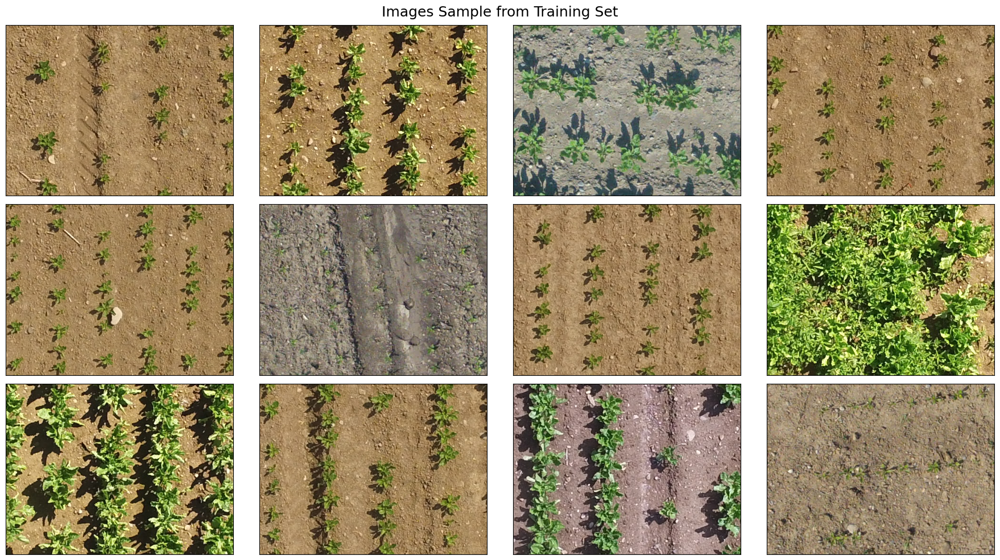

In [ ]:
fig, axs = plt.subplots(3, 4, figsize=(18, 10))
fig.suptitle('Images Sample from Training Set', fontsize=18)
for i, ax in enumerate(fig.axes):
    ax.imshow(center_crop(train_sample[i], (480, 360)))
    ax.set_xticks([])
    ax.set_yticks([])
plt.tight_layout()
plt.show()

#**2) MODELS DEFINITION**

---


## **Traditional approaches**

Defining the functions representing the traditional approaches:

- K-mean algorithm
- thresholding, aka the Otsu's algorithm
- Simple Linear Iterative Clustering (SLIC)

In [ ]:
def clustering_segmentation(img):
    """Applies image segmentation based on k-Means clustering algorithm
	Args:
	img: RGB image
	Returns:
	segmented: Segmented image in which all pixels are of the color of the centroid
	mask: Black and Green mask (Black=NoCrops, Green=Crops)
    """
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)
    k = 2
    img = cv2.blur(img, ksize = (15, 15))
    _, labels, (centers) = cv2.kmeans(np.float32(img.reshape((-1, 3))), k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    # convert all pixels to the color of the centroids
    centers = np.uint8(centers)
    labels = labels.flatten()
    segmented = centers[labels]
    segmented = segmented.reshape(img.shape)
    mask = np.copy(img)
    mask = mask.reshape((-1, 3))
    u, c = np.unique(labels, return_counts=True)
    if (np.argmax(c) == 0):
        mask[labels == 1] = [0, 255, 0]
        mask[labels == 0] = [0, 0, 0]
    else:
        mask[labels == 1] = [0, 0, 0]
        mask[labels == 0] = [0, 255, 0]
    mask = mask.reshape(img.shape)
    return segmented, get2Dmask(mask)

def thresholding_segmentation(img, rgb=True, inverse=False):
    """Applies image segmentation based on thresholding, aka the Otsu's algorithm
	Args:
	img: Image
    rgb: Whether a given image is RGB or B/W
	Returns:
	threshold: Threshold applied to separate pixel
	mask: Black and Green mask (Black=NoCrops, Green=Crops)
    """
    if rgb:
        img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    img = cv2.blur(img, ksize = (15, 15))
    # OTSU'S ALGORITHM
    hist, bins = np.histogram(img, bins=256)
    # Calculate centers of bins
    bins_mids = (bins[:-1] + bins[1:]) / 2.
    # Iterate over all thresholds (indices) and get the probabilities w1(t), w2(t)
    w1 = np.cumsum(hist)
    w2 = np.cumsum(hist[::-1])[::-1]
    # Get the classes means mu0(t) and mu1(t)
    mean1 = np.cumsum(hist * bins_mids) / w1
    mean2 = (np.cumsum((hist * bins_mids)[::-1]) / w2[::-1])[::-1]
    inter_class_variance = w1[:-1] * w2[1:] * (mean1[:-1] - mean2[1:]) ** 2
    index_of_max_val = np.argmax(inter_class_variance)
    threshold = bins_mids[:-1][index_of_max_val]
    _, mask = cv2.threshold(img, threshold, 255, cv2.THRESH_BINARY_INV if inverse else cv2.THRESH_BINARY)
    return threshold, mask

def slic_segmentation(img, n_segments=100):
    """Applies image segmentation based on SIMPLE LINEAR ITERATIVE CLUSTERING algorithm
	Args:
	img: RGB image
	n_segments: Segments in which divide the image
	Returns:
	segments: Segments found
	boundaries: Image where segment's boundaries are applied
    """
    img = img_as_float(img)
    segments = slic(img, n_segments = n_segments, sigma = 5)
    boundaries = mark_boundaries(img, segments)
    return segments, boundaries

Plotting a sample given by the application of the above algorithms and visually comparing the results.

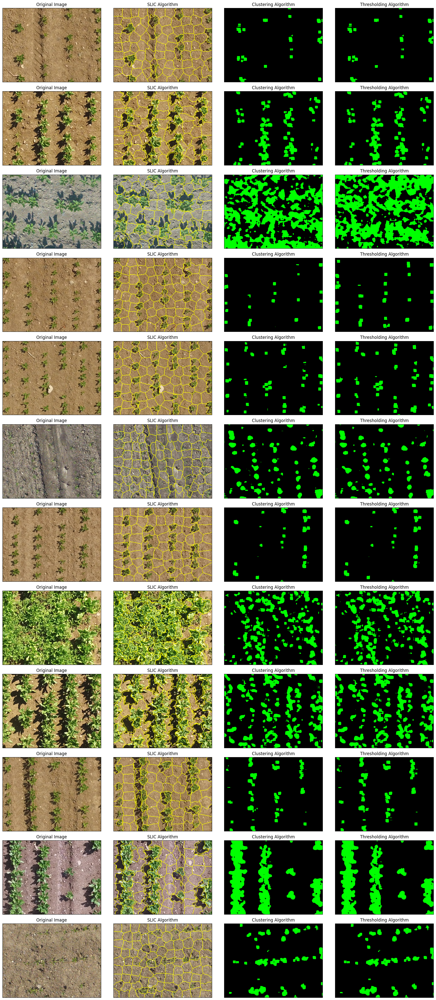

In [ ]:
fig, axs = plt.subplots(12, 4, figsize=(18, 40))
for i in range(len(train_sample)):
    img = train_sample[i]
    img = center_crop(img, (480, 360))
    _, boundaries = slic_segmentation(img)
    _, m_cluster = clustering_segmentation(applyGreenFilter(img))
    _, m_threshold = thresholding_segmentation(applyGreenFilter(img))

    fig.axes[i*4].imshow(img)
    fig.axes[i*4+1].imshow(boundaries)
    fig.axes[i*4+2].imshow(get3Dmask(m_cluster))
    fig.axes[i*4+3].imshow(get3Dmask(m_threshold))

    fig.axes[i*4].set_title('Original Image')
    fig.axes[i*4+1].set_title('SLIC Algorithm')
    fig.axes[i*4+2].set_title('Clustering Algorithm')
    fig.axes[i*4+3].set_title('Thresholding Algorithm')

    fig.axes[i*4].set_xticks([])
    fig.axes[i*4].set_yticks([])
    fig.axes[i*4+1].set_xticks([])
    fig.axes[i*4+1].set_yticks([])
    fig.axes[i*4+2].set_xticks([])
    fig.axes[i*4+2].set_yticks([])
    fig.axes[i*4+3].set_xticks([])
    fig.axes[i*4+3].set_yticks([])

plt.tight_layout()
plt.show()

## **Deep Learning Approaches**

###**Defining model architecture**

**U-Net** architecture followed by its implementation in Pytorch.

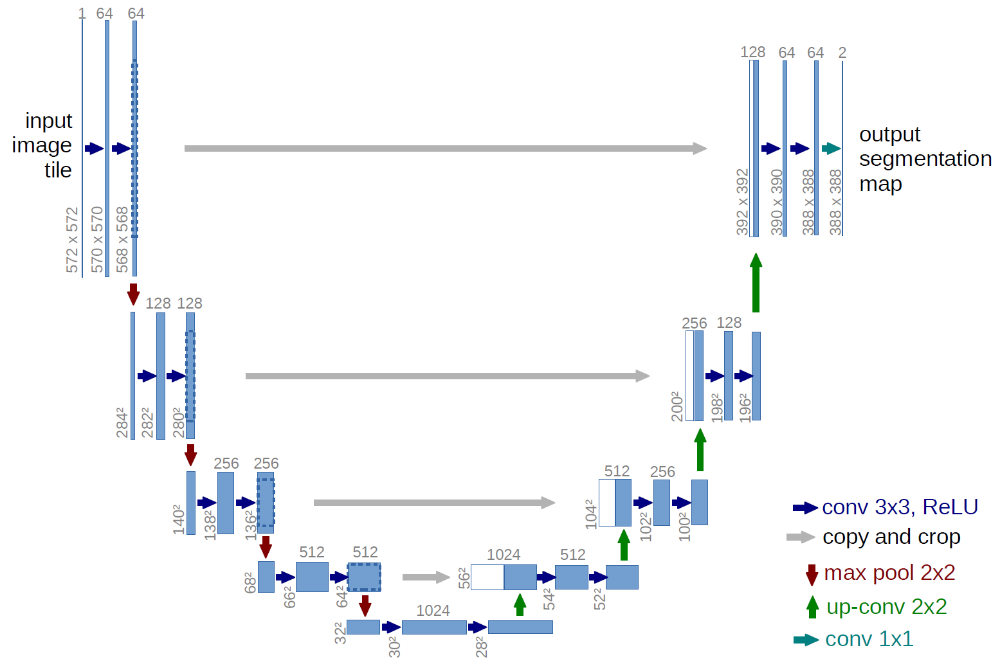

Defining models parameters and input transformations.

In [ ]:
PIN_MEMORY = True if device == 'cuda' else False
INIT_LR = 0.1 # esperiment 1
NUM_EPOCHS = 10
BATCH_SIZE = 10 # experiment 1
INPUT_IMAGE_WIDTH = 480
INPUT_IMAGE_HEIGHT = 360
THRESHOLD = 0.5

transform = transforms.Compose([
                transforms.ToPILImage(),
                transforms.PILToTensor(),
                transforms.ConvertImageDtype(torch.float)
            ])

Defining the model classes and a custom Dataset class.

In [ ]:
class Block(nn.Module):
	def __init__(self, inChannels, outChannels):
		super().__init__()
		self.conv1 = nn.Conv2d(inChannels, outChannels, 3)
		self.relu = nn.ReLU()
		self.conv2 = nn.Conv2d(outChannels, outChannels, 3)
	def forward(self, x):
		return self.conv2(self.relu(self.conv1(x)))

class Encoder(nn.Module):
	def __init__(self, channels=(3, 16, 32, 64)):
		super().__init__()
		self.encBlocks = nn.ModuleList([Block(channels[i], channels[i + 1]) for i in range(len(channels) - 1)])
		self.pool = nn.MaxPool2d(2)
	def forward(self, x):
		blockOutputs = []
		for block in self.encBlocks:
			x = block(x)
			blockOutputs.append(x)
			x = self.pool(x)
		return blockOutputs

class Decoder(nn.Module):
	def __init__(self, channels=(64, 32, 16)):
		super().__init__()
		self.channels = channels
		self.upconvs = nn.ModuleList([nn.ConvTranspose2d(channels[i], channels[i + 1], 2, 2) for i in range(len(channels) - 1)])
		self.dec_blocks = nn.ModuleList([Block(channels[i], channels[i + 1]) for i in range(len(channels) - 1)])
	def forward(self, x, encFeatures):
		for i in range(len(self.channels) - 1):
			x = self.upconvs[i](x)
			encFeat = self.crop(encFeatures[i], x)
			x = torch.cat([x, encFeat], dim=1)
			x = self.dec_blocks[i](x)
		return x
	def crop(self, encFeatures, x):
		(_, _, H, W) = x.shape
		encFeatures = CenterCrop([H, W])(encFeatures)
		return encFeatures

class UNet(nn.Module):
    def __init__(self, encChannels=(3, 16, 32, 64), decChannels=(64, 32, 16), retainDim=True, outSize=(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)):
        super().__init__()
        self.encoder = Encoder(encChannels)
        self.decoder = Decoder(decChannels)
        self.head = nn.Conv2d(decChannels[-1], 1, 1)
        self.retainDim = retainDim
        self.outSize = outSize
    def forward(self, x):
        encFeatures = self.encoder(x)
        decFeatures = self.decoder(encFeatures[::-1][0], encFeatures[::-1][1:])
        map = self.head(decFeatures)
        if self.retainDim:
            map = F.interpolate(map, self.outSize)
        return map

class MyCustomDataset(Dataset):
	def __init__(self, imagePaths, maskPaths, transforms):
		self.imagePaths = imagePaths
		self.maskPaths = maskPaths
		self.transforms = transforms
	def __len__(self):
		return len(self.imagePaths)
	def __getitem__(self, idx):
		imagePath = self.imagePaths[idx]
		maskPath = self.maskPaths[idx]
		image = io.imread(imagePath)
		mask = io.imread(maskPath)
		if self.transforms is not None:
			image = self.transforms(image)
			mask = self.transforms(mask)
		return (image, mask)

###**Images preprocessing**

Preprocess the original images and saving to files.

Preprocessing steps (TESTING):
- Merged labels (weed and crop).


---


*Note: see the final report for more details.*

In [ ]:
%%script false --no-raise-error
# Script for saving test data
_, test_data = getData([], addTest=True, verbose=True)
for i in range(len(test_data)):
    if i % 20 == 0:
        print(str(i)+'/'+str(len(test_data)))
    name = "{:05d}".format(len(os.listdir('/content/testing_data')))+'.jpg'
    io.imsave('/content/testing_data/'+name, test_data[i][0])
    io.imsave('/content/testing_labels/'+name, test_data[i][1])

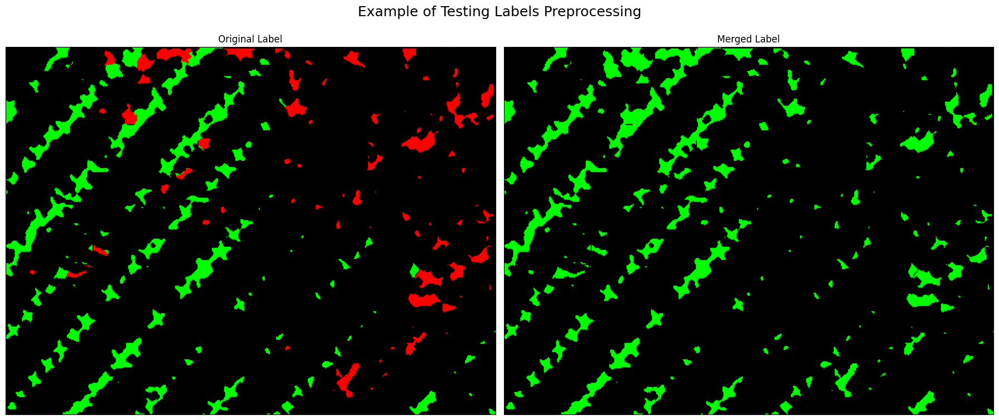

In [ ]:
fig, (ax1,ax2) = plt.subplots(1, 2, figsize=(18, 8))
fig.suptitle('Example of Testing Labels Preprocessing', fontsize=18)
path = 'https://cdn.albertovalerio.com/datasets/crop_segmentation/weedmap/Tiles/RedEdge/003/groundtruth/003_frame0020_GroundTruth_color.png'
label = io.imread(path)
label_m = merge_labels(label)
label_m = get3Dmask(label_m)
ax1.imshow(label)
ax2.imshow(label_m)
ax1.set_title('Original Label')
ax2.set_title('Merged Label')
ax1.set_xticks([])
ax1.set_yticks([])
ax2.set_xticks([])
ax2.set_yticks([])
plt.tight_layout()
plt.show()

Preprocessing steps (TRAINING):
- Divided each image in patches.
- Saturated green channel and removed background.
- Applied low level segmentation based on clustering algorithm.
- Applied random black mask.


---


*Note: see the final report for more details.*

In [ ]:
%%script false --no-raise-error
# Script for saving train data
train_data, _ = getData(TRAIN_PATHS[4:], verbose=True)
for i in range(len(train_data)):
    if i % 20 == 0:
        print(str(i)+'/'+str(len(train_data)))
    tiles = getTiles(train_data[i], H=360, W=480)
    tiles_cluster = applyLowLevelSegmentation(tiles)
    x, y = applyRandomDistorsion(tiles, tiles_cluster)
    for j in range(len(x)):
        name = "{:05d}".format(len(os.listdir('/content/training_data')))+'.jpg'
        io.imsave('/content/training_data/'+name, x[j])
        io.imsave('/content/training_labels/'+name, y[j])

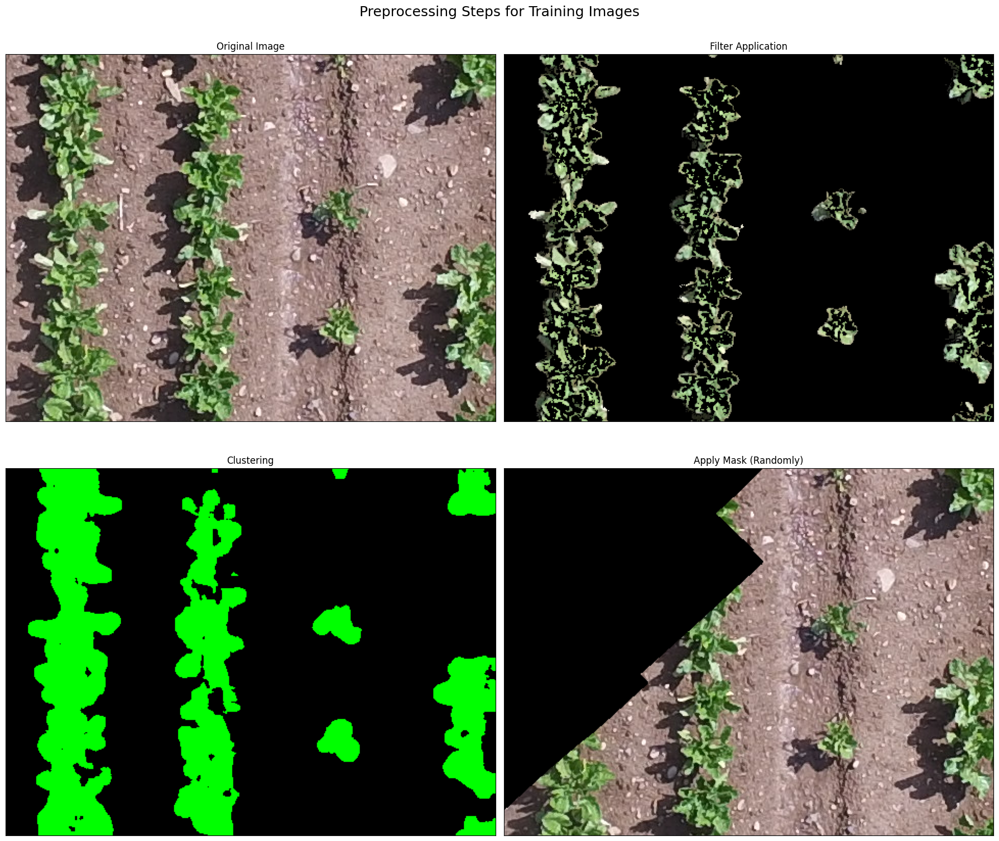

In [ ]:
fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(18, 16))
fig.suptitle('Preprocessing Steps for Training Images', fontsize=18)
mask = io.imread('https://cdn.albertovalerio.com/datasets/crop_segmentation/weedmap/Tiles/RedEdge/003/mask/frame0081.png')
img = train_sample[10]
img = center_crop(img, (480, 360))
_, clustered = clustering_segmentation(applyGreenFilter(img))
ax1.imshow(img)
ax2.imshow(applyGreenFilter(img))
ax3.imshow(get3Dmask(clustered))
ax4.imshow(cv2.bitwise_and(img, img, mask=mask))
ax1.set_title('Original Image')
ax2.set_title('Filter Application')
ax3.set_title('Clustering')
ax4.set_title('Apply Mask (Randomly)')
ax1.set_xticks([])
ax1.set_yticks([])
ax2.set_xticks([])
ax2.set_yticks([])
ax3.set_xticks([])
ax3.set_yticks([])
ax4.set_xticks([])
ax4.set_yticks([])
plt.tight_layout()
plt.show()

In [ ]:
%%script false --no-raise-error
%%capture
!zip -r /content/file2.zip /content
from google.colab import files
files.download("/content/file2.zip")

###**Training the model**


In [ ]:
imagePaths = [PROCESSED[0]+i for i in get_images(PROCESSED[0])]
maskPaths = [PROCESSED[1]+i for i in get_images(PROCESSED[1])]

X_train, X_val, y_train, y_val = train_test_split(
                                            imagePaths,
                                            maskPaths,
                                            train_size = .8,
                                            test_size = .2,
                                            random_state = 3,
                                            shuffle=True)

sampleT = int(len(X_train)*.25)
sampleV = int(len(X_val)*.25)

trainingDS = MyCustomDataset(imagePaths=X_train[:sampleT], maskPaths=y_train[:sampleT], transforms=transform)
validationDS = MyCustomDataset(imagePaths=X_val[:sampleV], maskPaths=y_val[:sampleV], transforms=transform)
trainLoader = DataLoader(trainingDS, shuffle=True, batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY, num_workers=os.cpu_count())
valLoader = DataLoader(validationDS, shuffle=False, batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY, num_workers=os.cpu_count())

In [ ]:
print(''.join(['> ' for i in range(40)]))
print(f'\n{"":<25}{"TRAIN_SET":<18}{"VAL_SET":<18}\n')
print(''.join(['> ' for i in range(40)]))

print(f'\n{"SIZE":<25}{len(trainingDS):<18}{len(validationDS):<18}\n')

> > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > 

                         TRAIN_SET         VAL_SET           

> > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > 

SIZE                     7100              1775              



In [ ]:
unet = UNet().to(device)
lossFunc = BCEWithLogitsLoss()
opt = Adam(unet.parameters(), lr=INIT_LR)
trainSteps = len(trainingDS) // BATCH_SIZE
testSteps = len(validationDS) // BATCH_SIZE
H = {'train_loss': [], 'val_loss': [], 'test_loss': []}

In [ ]:
for e in tqdm(range(NUM_EPOCHS)):
    unet.train()
    totalTrainLoss = 0
    totalValLoss = 0

    for (i, (x, y)) in enumerate(trainLoader):
        (x, y) = (x.to(device), y.to(device))
        pred = unet(x)
        loss = lossFunc(pred, y)
        opt.zero_grad()
        loss.backward()
        opt.step()
        totalTrainLoss += loss
    with torch.no_grad():
        unet.eval()
        for (x, y) in valLoader:
            (x, y) = (x.to(device), y.to(device))
            pred = unet(x)
            totalValLoss += lossFunc(pred, y)

        avgTrainLoss = totalTrainLoss / trainSteps
        avgValLoss = totalValLoss / testSteps
        H['train_loss'].append(avgTrainLoss.cpu().detach().numpy())
        H['val_loss'].append(avgValLoss.cpu().detach().numpy())

        print(" EPOCH: {}/{}".format(e + 1, NUM_EPOCHS))
        print("Train loss: {:.6f}, Test loss: {:.4f}".format(avgTrainLoss, avgValLoss))

torch.save(unet, 'my_unet_model.pth')

 10%|█         | 1/10 [12:17<1:50:36, 737.42s/it]

 EPOCH: 1/10
Train loss: 0.424308, Test loss: 0.3834


 20%|██        | 2/10 [24:32<1:38:08, 736.12s/it]

 EPOCH: 2/10
Train loss: 0.364181, Test loss: 0.3567


 30%|███       | 3/10 [36:54<1:26:10, 738.70s/it]

 EPOCH: 3/10
Train loss: 0.352062, Test loss: 0.3487


 40%|████      | 4/10 [49:12<1:13:50, 738.45s/it]

 EPOCH: 4/10
Train loss: 0.345589, Test loss: 0.3424


 50%|█████     | 5/10 [1:01:28<1:01:27, 737.60s/it]

 EPOCH: 5/10
Train loss: 0.345375, Test loss: 0.3446


 60%|██████    | 6/10 [1:13:43<49:06, 736.55s/it]  

 EPOCH: 6/10
Train loss: 0.342319, Test loss: 0.3404


 70%|███████   | 7/10 [1:26:01<36:51, 737.22s/it]

 EPOCH: 7/10
Train loss: 0.340636, Test loss: 0.3394


 80%|████████  | 8/10 [1:38:17<24:33, 736.75s/it]

 EPOCH: 8/10
Train loss: 0.339365, Test loss: 0.3411


 90%|█████████ | 9/10 [1:50:35<12:17, 737.10s/it]

 EPOCH: 9/10
Train loss: 0.339530, Test loss: 0.3421


100%|██████████| 10/10 [2:02:47<00:00, 736.76s/it]

 EPOCH: 10/10
Train loss: 0.336871, Test loss: 0.3356


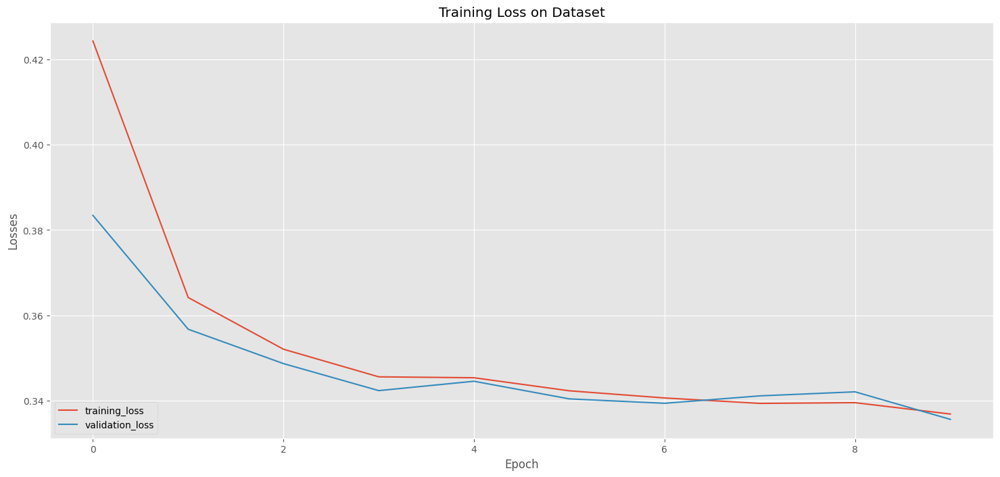

In [ ]:
plt.style.use("ggplot")
plt.figure()
plt.plot(H["train_loss"], label="training_loss")
plt.plot(H["val_loss"], label="validation_loss")
plt.title("Training Loss on Dataset")
plt.xlabel("Epoch")
plt.ylabel("Losses")
plt.legend(loc="lower left")

###**Testing the model**


Defining helper functions.

In [ ]:
def plot_result(origImage, origMask, predMask, idImage):
    fig, (ax1,ax2,ax3) = plt.subplots(1, 3, figsize=(18, 8))
    ax1.imshow(origImage)
    ax2.imshow(origMask)
    ax3.imshow(predMask)
    ax1.set_title('Original Image #'+str(idImage))
    ax2.set_title('Original Mask')
    ax3.set_title('Predicted Mask')
    ax1.set_xticks([])
    ax1.set_yticks([])
    ax2.set_xticks([])
    ax2.set_yticks([])
    ax3.set_xticks([])
    ax3.set_yticks([])
    fig.tight_layout()
    fig.show()

def make_predictions(model, testImgPath):
    image = io.imread(testImgPath)
    image = transform(image)
    image = image.unsqueeze(0)
    model.eval()
    with torch.no_grad():
        predMask = model(image.to(device)).squeeze()
        predMask = torch.sigmoid(predMask)
        predMask = predMask.cpu().numpy()
        predMask = (predMask > THRESHOLD) * 255
        predMask = predMask.astype(np.uint8)
    return predMask

Read a previously trained model.

In [ ]:
if not os.path.exists('my_unet_model.pth'):
    os.system('wget %s'%MODELS[0])
saved_model = torch.load('my_unet_model.pth',  map_location=torch.device(device))

Computing all testing set prediction and showing a relevent sample.

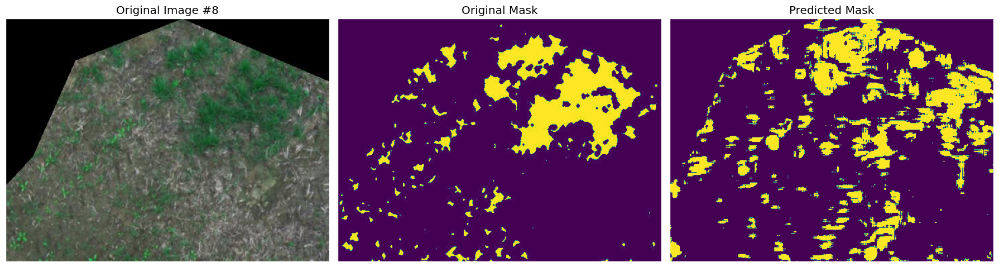

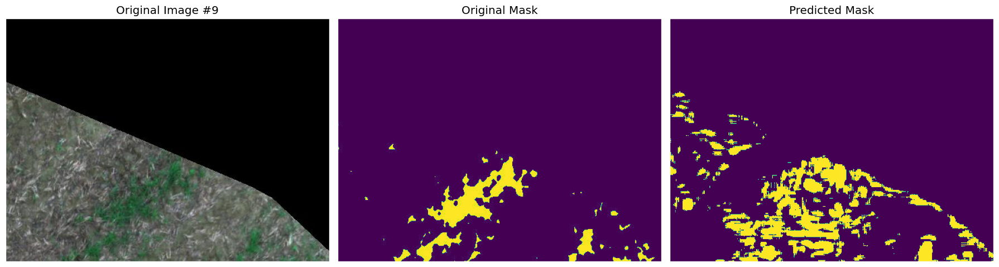

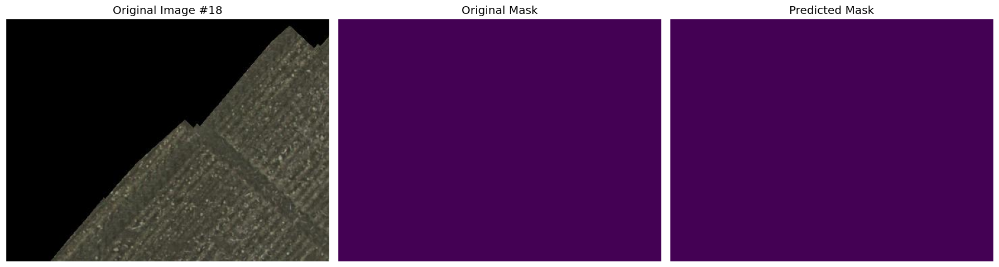

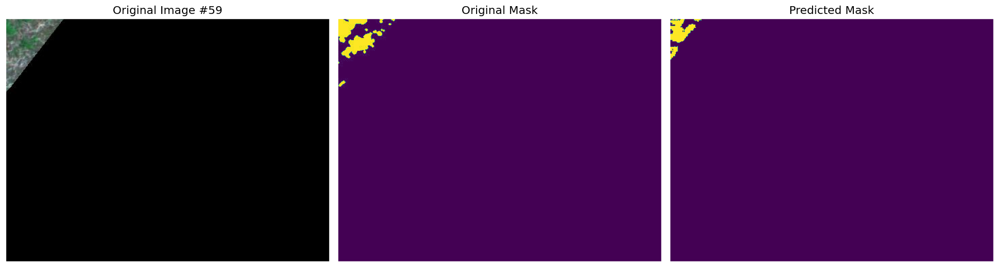

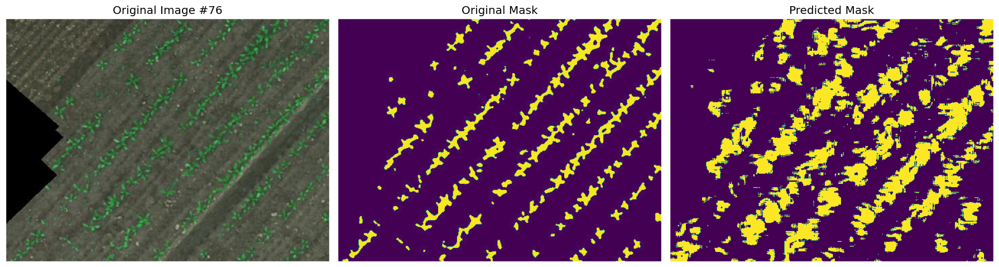

...

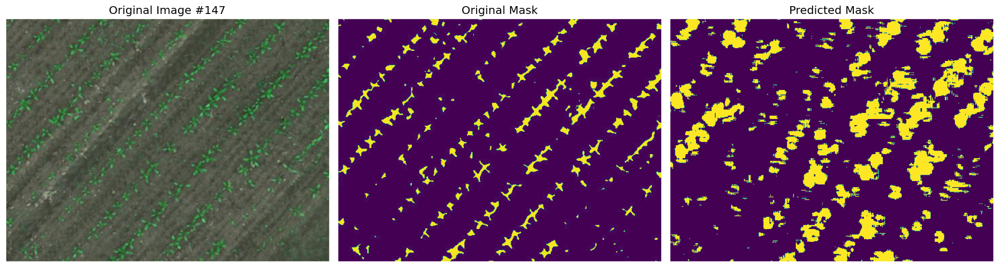

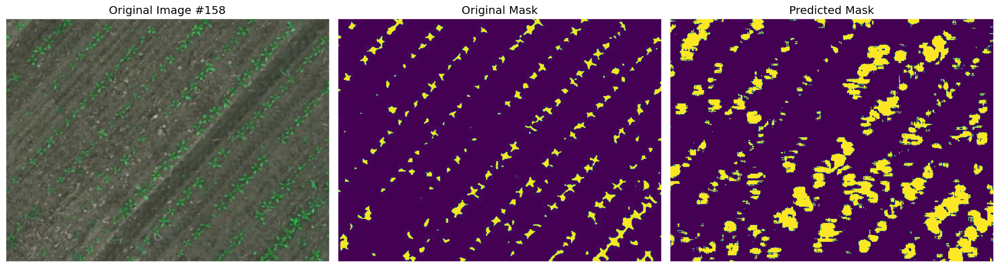

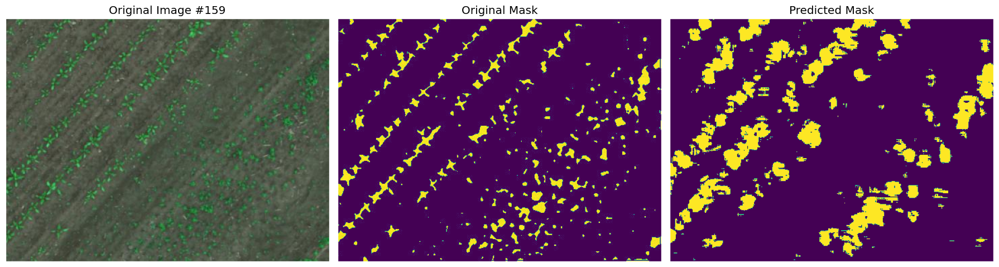

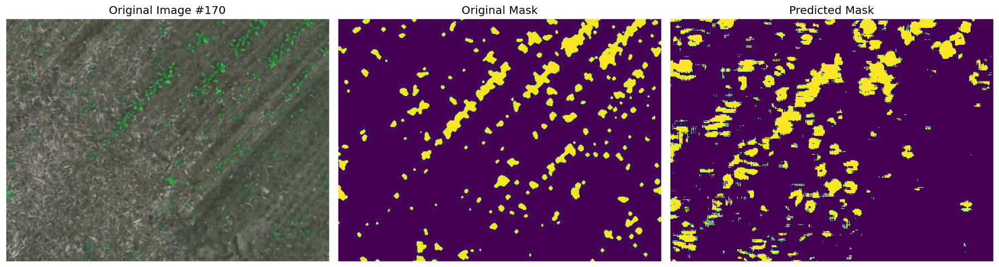

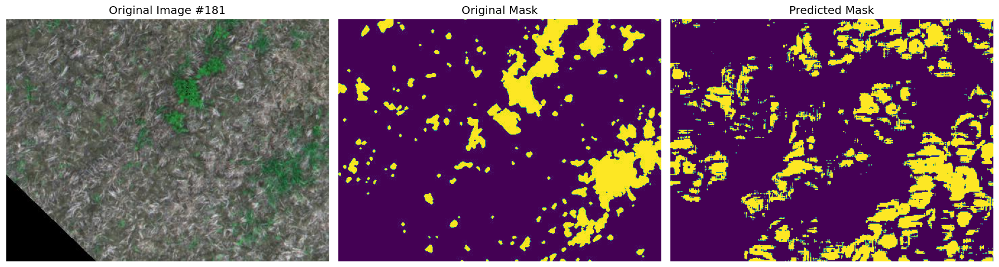

In [ ]:
samples = [8,9,18,59,76,81,87,92,98,99,122,132,147,158,159,170,181]

# contains paths
testImages = [PROCESSED[2]+i for i in get_images(PROCESSED[2])]

# contains BW images
testMasks = [io.imread(PROCESSED[3]+filename) for filename in get_images(PROCESSED[3])]
testPred = []
testPred_cluster = []

for i in range(len(testImages)):
    pred = make_predictions(saved_model, testImages[i])
    _, pred_cluster = clustering_segmentation(applyGreenFilter(io.imread(testImages[i])))
    testPred.append(pred)
    testPred_cluster.append(pred_cluster)

for i in samples:
    plot_result(io.imread(testImages[i]), testMasks[i], testPred[i], i)

###**Evaluation Measures**


**Pixel Accuracy**

Pixel accuracy is  the number of pixels that are classified correctly in the generated segmentation mask. (NOT THE BEST CHOICE!)


$$accuracy=\frac{TP+TN}{TP+TN+FP+FN}$$


This metric can sometimes provide misleading results when the class representation is small within the image, as the measure will be biased in mainly reporting how well you identify negative case (ie. where the class is not present).

In [ ]:
def pixelAccuracy(predictions, labels):
    all = predictions.shape[0] * predictions.shape[1]
    predictions = predictions.reshape(all)
    labels = labels.reshape(all)
    tp_tn = np.array([1 for (i,v) in enumerate(predictions) if v == labels[i]]).sum()
    return tp_tn / all * 100

In [ ]:
accuracy = {
    'unet': np.array([pixelAccuracy(v, testMasks[i]) for (i,v) in enumerate(testPred)]),
    'unet_redu': [],
    'cluster': np.array([pixelAccuracy(v, testMasks[i]) for (i,v) in enumerate(testPred_cluster)]),
    'cluster_redu': []
}

for i in range(len(testMasks)):
    if not np.all(testMasks[i] == 0):
        accuracy['unet_redu'].append(pixelAccuracy(testPred[i], testMasks[i]))
        accuracy['cluster_redu'].append(pixelAccuracy(testPred_cluster[i], testMasks[i]))

accuracy['unet_redu'] = np.array(accuracy['unet_redu'])
accuracy['cluster_redu'] = np.array(accuracy['cluster_redu'])

print(f'{"the mean accuracy is: ".upper()}\033[32m \033[01m{accuracy["unet"].mean():.2f}%\033[30m \033[0m{" for the whole test set.".upper()}')
print(f'{"the mean accuracy is: ".upper()}\033[32m \033[01m{accuracy["unet_redu"].mean():.2f}%\033[30m \033[0m{" for test set minus all black images.".upper()}')

THE MEAN ACCURACY IS:  89.72%  FOR THE WHOLE TEST SET.
THE MEAN ACCURACY IS:  76.54%  FOR TEST SET MINUS ALL BLACK IMAGES.


**Intersection-Over-Union (Jaccard Index)**


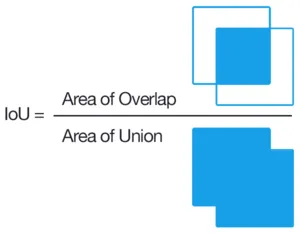

IoU is the area of overlap between the predicted segmentation and the ground truth divided by the area of union between the predicted segmentation and the ground truth.

$$J(A,B):=\frac{|A∩B|}{|A∪B|}=\frac{|A∩B|}{|A|+|B|-|A∩B|}$$

where **A** and **B** are the mask pixels: for example **A** is the predicted mask and **B** is the ground truth.

In [ ]:
jaccard = {
    'unet': np.array([jaccard_score(v.flatten(), testMasks[i].flatten(), average='micro')*100 for (i,v) in enumerate(testPred)]),
    'unet_redu': [],
    'cluster': np.array([jaccard_score(v.flatten(), testMasks[i].flatten(), average='micro')*100 for (i,v) in enumerate(testPred_cluster)]),
    'cluster_redu': []
}

for i in range(len(testMasks)):
    if not np.all(testMasks[i] == 0):
        jaccard['unet_redu'].append(jaccard_score(testPred[i].flatten(), testMasks[i].flatten(), average='micro')*100)
        jaccard['cluster_redu'].append(jaccard_score(testPred_cluster[i].flatten(), testMasks[i].flatten(), average='micro')*100)

jaccard['unet_redu'] = np.array(jaccard['unet_redu'])
jaccard['cluster_redu'] = np.array(jaccard['cluster_redu'])

print(f'{"the mean IoU is: ".upper()}\033[32m \033[01m{jaccard["unet"].mean():.2f}%\033[30m \033[0m{" for the whole test set.".upper()}')
print(f'{"the mean IoU is: ".upper()}\033[32m \033[01m{jaccard["unet_redu"].mean():.2f}%\033[30m \033[0m{" for test set minus all black images.".upper()}')

THE MEAN IOU IS:  83.93%  FOR THE WHOLE TEST SET.
THE MEAN IOU IS:  63.39%  FOR TEST SET MINUS ALL BLACK IMAGES.


#**3) RESULTS**


As a final results we made a comparison between the application of traditional techniques and the U-net model.

In [ ]:
print(''.join(['> ' for i in range(40)]))
print(f'\n{"":<35}{"CLUSTERING":<18}{"U-NET":<18}{"GAIN":<18}\n')
print(''.join(['> ' for i in range(40)]))

mean_ac = accuracy["cluster"].mean()
mean_acr = accuracy["cluster_redu"].mean()
mean_au = accuracy["unet"].mean()
mean_aur = accuracy["unet_redu"].mean()

mean_jc = jaccard["cluster"].mean()
mean_jcr = jaccard["cluster_redu"].mean()
mean_ju = jaccard["unet"].mean()
mean_jur = jaccard["unet_redu"].mean()

print(f'\n{"MEAN ACCURACY":<35}{mean_ac:<18.2f}{mean_au:<18.2f}\033[32m\033[01m{"+"+str(get_change(mean_au,mean_ac))+"%":<18}\033[30m\033[0m')
print(f'\n{"MEAN ACCURACY (NO BLACK)":<35}{mean_acr:<18.2f}{mean_aur:<18.2f}\033[32m\033[01m{"+"+str(get_change(mean_aur,mean_acr))+"%":<18}\033[30m\033[0m\n')
print(f'\n{"MEAN IoU":<35}{mean_jc:<18.2f}{mean_ju:<18.2f}\033[32m\033[01m{"+"+str(get_change(mean_ju,mean_jc))+"%":<18}\033[30m\033[0m')
print(f'\n{"MEAN IoU (NO BLACK)":<35}{mean_jcr:<18.2f}{mean_jur:<18.2f}\033[32m\033[01m{"+"+str(get_change(mean_jur,mean_jcr))+"%":<18}\033[30m\033[0m\n')

> > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > 

                                   CLUSTERING        U-NET             GAIN              

> > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > > 

MEAN ACCURACY                      87.04             89.72             +3.08%            

MEAN ACCURACY (NO BLACK)           72.51             76.54             +5.55%            


MEAN IoU                           80.09             83.93             +4.80%            

MEAN IoU (NO BLACK)                57.82             63.39             +9.63%            

